**End-to End Multi class classification problem**

**🐶🐕Using Transfer Learning and TensorFlow 2.0 to Classify Different Dog Breeds**

**1. Problem** 

Identify different breeds of dogs given in an image of a dog. Anyone can take photo of the dog, to know what breed of dog it is.

**2. Data**

We'll be using data from the [Kaggle dog breed identification competition](https://www.kaggle.com/c/dog-breed-identification/overview). It consists of a collection of 10,000+ labelled images of 120 different dog breeds.

**3. Evaluation**
Evaluations are evaluated on Multi Class Log Loss between the predicted probability and the observed target.

For each image in the test set, you must predict a probability for each of the different breeds. The file should contain a header and have the following format:
```
id,affenpinscher,afghan_hound,..,yorkshire_terrier
000621fb3cbb32d8935728e48679680e,0.0083,0.0,...,0.0083
etc.
```
https://www.kaggle.com/c/dog-breed-identification/overview/evaluation


**4. Features**

Some of the features of the data:
1. We are dealing with image(unstructured) data, so its best to use deep learning
2. There are 120 various breeds, that means we have 120 various classes, hence multi class classification problem.





Notes

Who's that doggy in the window?

This kind of problem is called **multi-class image classification**. It's multi-class because we're trying to classify mutliple different breeds of dog. If we were only trying to classify dogs versus cats, it would be called binary classification (one thing versus another).

Multi-class image classification is an important problem because it's the same kind of technology Tesla uses in their self-driving cars or Airbnb uses in atuomatically adding information to their listings.

Since the most important step in a deep learng problem is getting the data ready (turning it into numbers), that's what we're going to start with.

We're going to go through the following TensorFlow/Deep Learning workflow:
1. Get data ready (download from Kaggle, store, import).
2. Prepare the data (preprocessing, the 3 sets, X & y).
3. Choose and fit/train a model ([TensorFlow Hub](https://www.tensorflow.org/hub), `tf.keras.applications`, [TensorBoard](https://www.tensorflow.org/tensorboard), [EarlyStopping](https://www.tensorflow.org/api_docs/python/tf/keras/callbacks/EarlyStopping)).
4. Evaluating a model (making predictions, comparing them with the ground truth labels).
5. Improve the model through experimentation (start with 1000 images, make sure it works, increase the number of images).
6. Save, sharing and reloading your model (once you're happy with the results).

Side Note:A tensor is a generalization of vectors and matrices and is easily understood as a multidimensional array.

#Getting our workspace ready(Importing all dependencies)

Before we get started, since we'll be using TensorFlow 2.x and TensorFlow Hub (TensorFlow Hub), let's import them.

Useful resources: 
* https://towardsdatascience.com/how-to-choose-the-best-keras-pre-trained-model-for-image-classification-b850ca4428d4
*  https://www.analyticsvidhya.com/blog/2020/08/top-4-pre-trained-models-for-image-classification-with-python-code/
* 
*


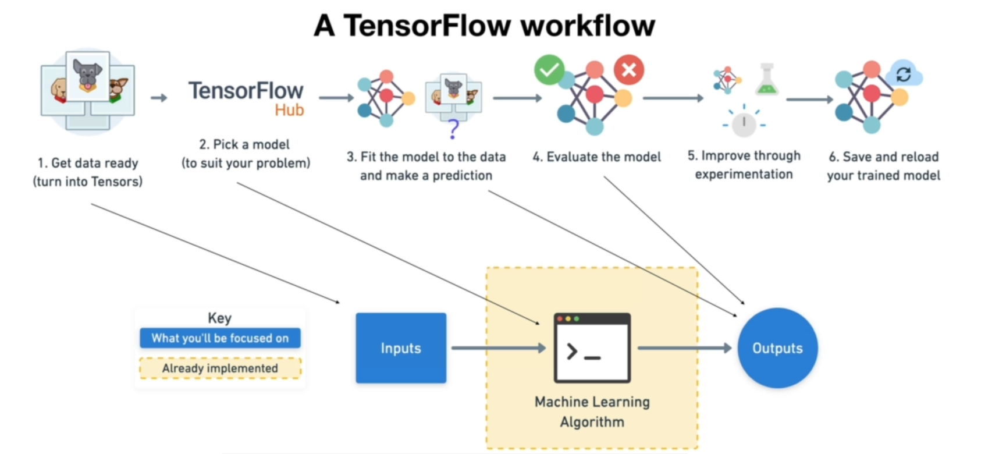

In [ ]:
workflow = {  "Get data ready (download from Kaggle, store, import).",
              "Prepare the data (preprocessing, the 3 sets, X & y).",
              "Choose and fit/train a model (TensorFlow Hub, tf.keras.applications, TensorBoard, EarlyStopping).",
              "Evaluating a model (making predictions, comparing them with the ground truth labels).",
             "Improve the model through experimentation (start with 1000 images, make sure it works, increase the number of images).",
              "Save, sharing and reloading your model (once you're happy with the results)."}

In [ ]:
# Data handling & Preprocess tools 
import pandas as pd
import numpy as np
import tensorflow as tf
import tensorflow_hub as hub

#File handling tools
import os 

#Visualization tools
import matplotlib
from matplotlib import cm
import matplotlib.pyplot as plt


from sklearn.model_selection import train_test_split

print({"Tensorflow Version": tf.__version__}) #Checking Tensorflow Version
print("Tensorflow Hub version", hub.__version__ ) #Checking Tensorflow Hub Version

#Checking GPU
print("GPU: ","Yesss! its Available🦾" if tf.config.list_physical_devices("GPU") else "Not Available,")
physical_devices = tf.config.list_physical_devices('GPU')
print("Num GPUs: ", len(physical_devices))
!nvidia-smi

{'Tensorflow Version': '2.6.0'}
Tensorflow Hub version 0.12.0
GPU:  Yesss! its Available🦾
Num GPUs:  1
Wed Sep 22 20:11:03 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 470.63.01    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla K80           Off  | 00000000:00:04.0 Off |                    0 |
| N/A   61C    P8    32W / 149W |      3MiB / 11441MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+---------

# Get the data ready(Turning into Tensors)
Turning our images(unstructure data) into numerical data(Tensors)

## Getting the csv file with id & breed names

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
df =  pd.read_csv("/content/drive/MyDrive/Colab Notebooks/projects_data/DogVision/labels.csv")
df.head()

,id,breed
0,000bec180eb18c7604dcecc8fe0dba07,boston_bull
1,001513dfcb2ffafc82cccf4d8bbaba97,dingo
2,001cdf01b096e06d78e9e5112d419397,pekinese
3,00214f311d5d2247d5dfe4fe24b2303d,bluetick
4,0021f9ceb3235effd7fcde7f7538ed62,golden_retriever


In [ ]:
df.describe()

,id,breed
count,10222,10222
unique,10222,120
top,6d2fe2807157cb6abb909806b4a73e93,scottish_deerhound
freq,1,126


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10222 entries, 0 to 10221
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   id      10222 non-null  object
 1   breed   10222 non-null  object
dtypes: object(2)
memory usage: 159.8+ KB


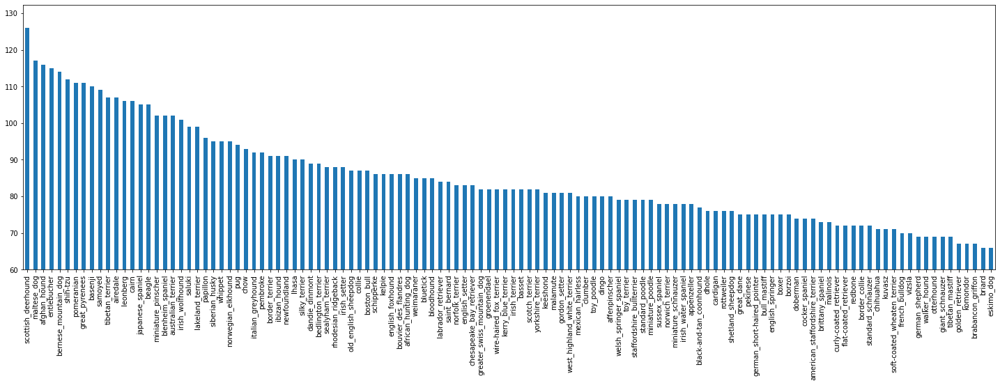

In [ ]:
#No of samples for each class of breed
df["breed"].value_counts().plot.bar(figsize=(25, 7), ylim=60);


Minimum number of images per class are >60 (greater than 60) which are greater than google colab minimum annotatations(examples) per class required( that is 10). 

	
For each label you must have at least 10 images, each with at least one annotation (bounding box and the label).However, for model training purposes it's recommended you use about 1000 annotations per label. In general, the more images per label you have the better your model will perform.[Read more...](https://cloud.google.com/vision/automl/object-detection/docs/prepare)


In [ ]:
#overall avarage of the samples for classes
df["breed"].value_counts().median()

82.0

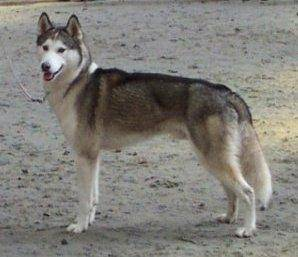

In [ ]:
#lets view an image 
from IPython.display import Image
Image("/content/drive/MyDrive/Colab Notebooks/projects_data/DogVision/train/1a013375fe1ee7dcf4b2189b3b68c43a.jpg")

## Getting Images with their labels
Getting images of all our file path names

In [ ]:
df.head()

,id,breed
0,000bec180eb18c7604dcecc8fe0dba07,boston_bull
1,001513dfcb2ffafc82cccf4d8bbaba97,dingo
2,001cdf01b096e06d78e9e5112d419397,pekinese
3,00214f311d5d2247d5dfe4fe24b2303d,bluetick
4,0021f9ceb3235effd7fcde7f7538ed62,golden_retriever


In [ ]:
#Create pathnames from image ids
filenames = []
filenames = ["/content/drive/MyDrive/Colab Notebooks/projects_data/DogVision/train/"+idnums for idnums in df.id+".jpg"]
print(len(filenames))                                                               #creating list of idnums, for idnums in ids
filenames[:5]

10222


['/content/drive/MyDrive/Colab Notebooks/projects_data/DogVision/train/000bec180eb18c7604dcecc8fe0dba07.jpg',
 '/content/drive/MyDrive/Colab Notebooks/projects_data/DogVision/train/001513dfcb2ffafc82cccf4d8bbaba97.jpg',
 '/content/drive/MyDrive/Colab Notebooks/projects_data/DogVision/train/001cdf01b096e06d78e9e5112d419397.jpg',
 '/content/drive/MyDrive/Colab Notebooks/projects_data/DogVision/train/00214f311d5d2247d5dfe4fe24b2303d.jpg',
 '/content/drive/MyDrive/Colab Notebooks/projects_data/DogVision/train/0021f9ceb3235effd7fcde7f7538ed62.jpg']

##Checking the data

### Checking if the directory files are of same size as of filenames

In [ ]:
import os
if len(os.listdir('/content/drive/MyDrive/Colab Notebooks/projects_data/DogVision/train/')) == len(filenames):
  print("Filenames match actual amount of files...Proceed!!!")
else:
  print("Filenmaes do not match the actual amount of files.")

Filenames match actual amount of files...Proceed!!!


### One more check on random pictures 

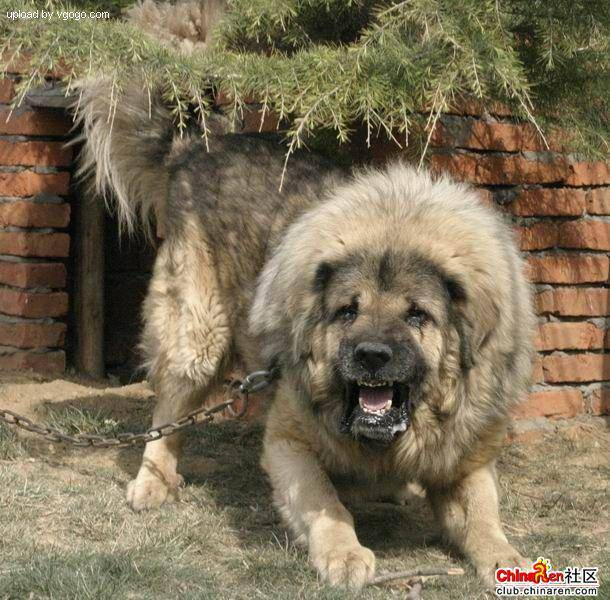

In [ ]:
Image(filenames[9000])

In [ ]:
df.breed[9000]

'tibetan_mastiff'

Since we have got our training image filepaths in a list, lets prepare our labels list

In [ ]:
labels = df.breed
# labels = df.breed.to_numpy() #turn the labels into numpy array nice simple method 
labels

0                     boston_bull
1                           dingo
2                        pekinese
3                        bluetick
4                golden_retriever
                   ...           
10217                      borzoi
10218              dandie_dinmont
10219                    airedale
10220          miniature_pinscher
10221    chesapeake_bay_retriever
Name: breed, Length: 10222, dtype: object

In [ ]:
# or do Turn labels to numpy array like this way
labels = np.array(labels)
labels

array(['boston_bull', 'dingo', 'pekinese', ..., 'airedale',
       'miniature_pinscher', 'chesapeake_bay_retriever'], dtype=object)

In [ ]:
len(labels)

10222

In [ ]:
#see if number of labels matches the number of filenames
if len(labels)  == len(filenames):
  print("Matched")
else:
  print("Not Matched")

Matched


### Checking total number of classes snd comparing them with unique classes

In [ ]:
# unique_breeds = labels.unique() gives same result as below
unique_breeds = np.unique(labels)
len(unique_breeds)

120

Since the number of classes are equal to the numbers of dog breed as provided in kaggle [dataset](https://www.kaggle.com/c/dog-breed-identification/data?select=labels.csv#:~:text=The%20dataset%20comprises-,120%20breeds%20of%20dogs,-.%20The%20goal%20of) that is 120 breeds of dogs, we will move forward

In [ ]:
unique_breeds

array(['affenpinscher', 'afghan_hound', 'african_hunting_dog', 'airedale',
       'american_staffordshire_terrier', 'appenzeller',
       'australian_terrier', 'basenji', 'basset', 'beagle',
       'bedlington_terrier', 'bernese_mountain_dog',
       'black-and-tan_coonhound', 'blenheim_spaniel', 'bloodhound',
       'bluetick', 'border_collie', 'border_terrier', 'borzoi',
       'boston_bull', 'bouvier_des_flandres', 'boxer',
       'brabancon_griffon', 'briard', 'brittany_spaniel', 'bull_mastiff',
       'cairn', 'cardigan', 'chesapeake_bay_retriever', 'chihuahua',
       'chow', 'clumber', 'cocker_spaniel', 'collie',
       'curly-coated_retriever', 'dandie_dinmont', 'dhole', 'dingo',
       'doberman', 'english_foxhound', 'english_setter',
       'english_springer', 'entlebucher', 'eskimo_dog',
       'flat-coated_retriever', 'french_bulldog', 'german_shepherd',
       'german_short-haired_pointer', 'giant_schnauzer',
       'golden_retriever', 'gordon_setter', 'great_dane',
      

In [ ]:
#Turn a single array into an array of booleans
print(labels[0])
labels[0] == unique_breeds

boston_bull


array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False,  True, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False])

##Turn every label into a boolean array

In [ ]:
boolean_labels =  [label == unique_breeds for label in labels]
boolean_labels[:2]

[array([False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False,  True, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False,
        False, False, False]),
 array([False, False, False, False, False, Fal

In [ ]:
print(len(boolean_labels))
len(boolean_labels) == len(labels)
#So it had done the boolean array comparisn for every label in labels

10222


True

In [ ]:
#Turning boolean array into integer
for i in range (0, 2, 1):
  print(labels[i]) #Original label
  print(np.where(unique_breeds == labels[i])) # index where label occurs
  print(boolean_labels[i].argmax()) # index where label occurs in boolean array
  print(boolean_labels[i].astype(int)) # there will be 1 where the sample label occurs

boston_bull
(array([19]),)
19
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0]
dingo
(array([37]),)
37
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0]


#Creating Validation Set
Since Kaggle Dataset doesnot provide as with validation set, we are gonna make one

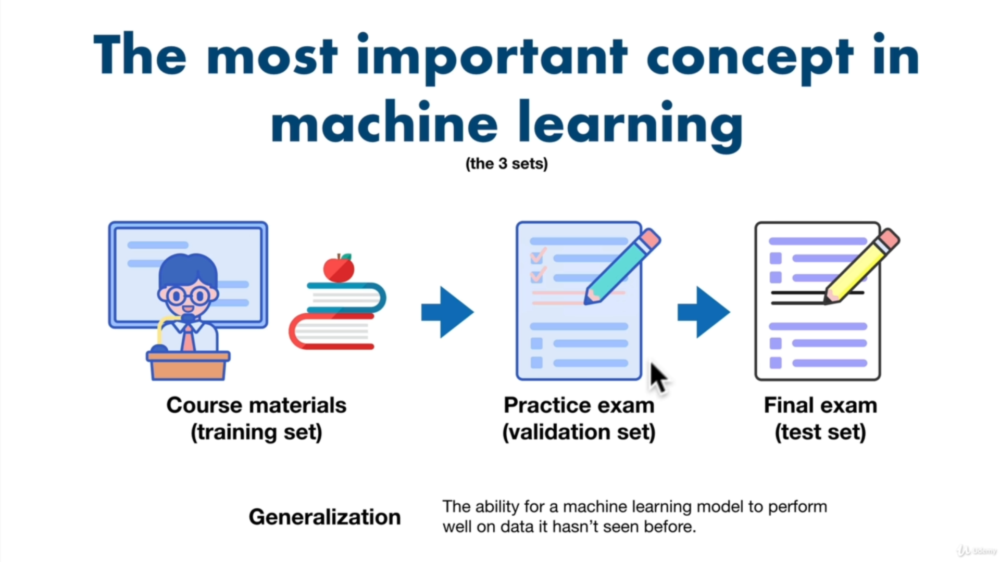

In [ ]:
#Turning the data into X and y
X = filenames
y = boolean_labels

In [ ]:
len(filenames)

10222

We are gonna start off with experimenting with ~1000 images and increase as we need


In [ ]:
#Set number of images to use for experimenting
NUM_IMAGES = 1000 #@param {type: "slider", min:1000, max:10222, step:1}
NUM_IMAGES

1000

In [ ]:
#Lets split our data into train and test splits
from sklearn.model_selection import train_test_split
X_train, X_val, y_train, y_val = train_test_split(X[:NUM_IMAGES], 
                                                  y[:NUM_IMAGES],
                                                  test_size=0.2,
                                                  random_state=42) #Validation size is 20 of NUM_IMAGES 

In [ ]:
len(X_train), len(y_train), len(X_val), len(y_val)

(800, 800, 200, 200)

In [ ]:
X_val[:5], y_val[:2]

(['/content/drive/MyDrive/Colab Notebooks/projects_data/DogVision/train/0ca9280205bd68d201e1d708db3f209d.jpg',
  '/content/drive/MyDrive/Colab Notebooks/projects_data/DogVision/train/12405b2e93417d81f5308769c4e184c7.jpg',
  '/content/drive/MyDrive/Colab Notebooks/projects_data/DogVision/train/1242da788ce85d4311e1cc9922a0a809.jpg',
  '/content/drive/MyDrive/Colab Notebooks/projects_data/DogVision/train/1015e4eba660def32e7e52b89fe3a9c6.jpg',
  '/content/drive/MyDrive/Colab Notebooks/projects_data/DogVision/train/09d5ac8026b8a7f7d1acae244765fe24.jpg'],
 [array([False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False,  True,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         Fal

In [ ]:
X_train[:5], y_train[:2]

(['/content/drive/MyDrive/Colab Notebooks/projects_data/DogVision/train/00bee065dcec471f26394855c5c2f3de.jpg',
  '/content/drive/MyDrive/Colab Notebooks/projects_data/DogVision/train/0d2f9e12a2611d911d91a339074c8154.jpg',
  '/content/drive/MyDrive/Colab Notebooks/projects_data/DogVision/train/1108e48ce3e2d7d7fb527ae6e40ab486.jpg',
  '/content/drive/MyDrive/Colab Notebooks/projects_data/DogVision/train/0dc3196b4213a2733d7f4bdcd41699d3.jpg',
  '/content/drive/MyDrive/Colab Notebooks/projects_data/DogVision/train/146fbfac6b5b1f0de83a5d0c1b473377.jpg'],
 [array([False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False,  True,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         False, False, False, False, False, False, False, False, False,
         Fal

# Preprocessing Images (turning images into Tensors)

To preprocess our images into Tensors we are going to write a function  which does a few things:
1. Take an image filepath as input
2. Use Tensorflow to read the file and save it to a variable, `image`
3. Turn our `image`(a jpg) into Tensor 
4. Normalize our image(convert color channel values from 0-255 to 0-1)
4. Resize the image to shape of (224, 224)
5. Return the modified `image`

Resources:

* https://www.tensorflow.org/guide/data
* https://www.tensorflow.org/tutorials/load_data/images


Our labels are in numeric format but our images are still just file paths.

Since we're using TensorFlow, our data has to be in the form of Tensors.

A Tensor is a way to represent information in numbers. If you're familar with NumPy arrays (you should be), a Tensor can be thought of as a combination of NumPy arrays, except with the special ability to be used on a GPU.

Because of how TensorFlow stores information (in Tensors), it allows machine learning and deep learning models to be run on GPUs (generally faster at numerical computing).

To preprocess our images into Tensors we're going to write a function which does a few things:

Takes an image filename as input.
Uses TensorFlow to read the file and save it to a variable, image.
Turn our image (a jpeg file) into Tensors.
Resize the image to be of shape (224, 224).
Return the modified image.
A good place to read about this type of function is the TensorFlow documentation on loading images.

You might be wondering why (224, 224), which is (heigh, width). It's because this is the size of input our model (we'll see this soon) takes, an image which is (224, 224, 3).

What? Where's the 3 from? We're getting ahead of ourselves but that's the number of colour channels per pixel, red, green and blue.

Let's make this a little more concrete.

In [ ]:
#convert image to Numpy array
from matplotlib.pyplot import imread
image = imread(filenames[42])      #Reading the image with imageread(imread)
image.shape
#(height, width, color channel)   3= number of color channels are Red, Blue and Green

(257, 350, 3)

In [ ]:
image.max(), image.min() #this shows pixel value for each Red and Blue and Green are seperately between 255 to 0

(255, 0)

In [ ]:
image[42] #THIS is in np.array (ndarry)

array([[46, 88, 76],
       [46, 88, 76],
       [47, 89, 79],
       ...,
       [38, 80, 58],
       [39, 78, 57],
       [39, 78, 57]], dtype=uint8)

In [ ]:
tf.constant(image)[:2] #image converted to tensor(this is a tensor)

<tf.Tensor: shape=(2, 350, 3), dtype=uint8, numpy=
array([[[ 89, 137,  87],
        [ 76, 124,  74],
        [ 63, 111,  59],
        ...,
        [ 76, 134,  86],
        [ 76, 134,  86],
        [ 76, 134,  86]],

       [[ 72, 119,  73],
        [ 67, 114,  68],
        [ 63, 111,  63],
        ...,
        [ 75, 131,  84],
        [ 74, 132,  84],
        [ 74, 131,  86]]], dtype=uint8)>

In [ ]:
# Define image size
IMAGE_SIZE =224 
# Create a function for processing images
def process_image(image_path, image_size=IMAGE_SIZE):
  """
  Takes an image file path and turns the image into a Tensor
  """
  #Read in an image file
  image = tf.io.read_file(image_path)
  #Turn the jpeg image into tensor with 3 color channels (Red, Green, Blue)
  image = tf.image.decode_jpeg(image, channels=3)
  #Convert the color channel  values from 0-255 to 0-1 (Doing Normalization)
  image = tf.image.convert_image_dtype(image, tf.float32)
  #Resize the image to our desired value(244, 244)
  image = tf.image.resize(image, size=[image_size, image_size])
  #returning the image
  return image

In [ ]:
#  #A better way of doing what we did in two upper steps above the function and also the demo of the above function
# tensor = tf.io.read_file(filenames[42])  #Reading the file 
# tensor; #So this image is in a tensor string which we cannot understand but the computer can

In [ ]:
# tensor = tf.image.decode_jpeg(tensor, channels=3) #So again image converted into tensor as seen two upper steps above the function
# tensor;

In [ ]:
# tensor=  tf.image.convert_image_dtype(tensor, tf.float32) #So it has the same shape but the value of 0-255 is now converted between 0-1
# tensor; #This is called Normalization

In [ ]:
# tf.image.resize(tensor, size=[255, 255]);

## Turning our data into batch size

Why turn our data into batches?

Lets say we are trying to process 10,000+ images in one go...
they might not all fit into our memory(RAM)

So thats why we do about 32 images(this is batch size) images at a time(you can manually adjust the batch size if need be)

In order to use Tensorflow effectively, we need our data in the form of Loop form of Tensor tuples which look like this:

`(image, labels)` 

### Function that returns a tensor tuple: 

In [ ]:

#Create a simple fucntion that returns a tuple (image, label)
def get_image_label(image_path, label):
  """
  Takes the image file path name and the associated label,
  process the image and returns a tuple of (image, label).
  """
  image= process_image(image_path)  
  return image,label

In [ ]:
#Demo of the above
# (process_image(X[42]), y[42]) #so our image is in a tensor but our label is not in a tensor we could do that by going(tf.constant(y[42]))
#SO this could be 
(process_image(X[42]), tf.constant(y[42])) #So we have got the tuple of "image and label pair" in the form of tensors

(<tf.Tensor: shape=(224, 224, 3), dtype=float32, numpy=
 array([[[0.3264178 , 0.5222886 , 0.3232816 ],
         [0.2537167 , 0.44366494, 0.24117757],
         [0.25699762, 0.4467087 , 0.23893751],
         ...,
         [0.29325107, 0.5189916 , 0.3215547 ],
         [0.29721776, 0.52466875, 0.33030328],
         [0.2948505 , 0.5223015 , 0.33406618]],
 
        [[0.25903144, 0.4537807 , 0.27294815],
         [0.24375686, 0.4407019 , 0.2554778 ],
         [0.2838985 , 0.47213382, 0.28298813],
         ...,
         [0.2785345 , 0.5027992 , 0.31004712],
         [0.28428748, 0.5108719 , 0.32523635],
         [0.28821915, 0.5148036 , 0.32916805]],
 
        [[0.20941195, 0.40692952, 0.25792548],
         [0.24045378, 0.43900946, 0.2868911 ],
         [0.29001117, 0.47937486, 0.32247734],
         ...,
         [0.26074055, 0.48414773, 0.30125174],
         [0.27101526, 0.49454468, 0.32096273],
         [0.27939945, 0.5029289 , 0.32934693]],
 
        ...,
 
        [[0.00634795, 0.03442048

Now we have got a way to turn our data into tuples `(image, labels)`. So now lets turn all our data(`X` & `y`)  into batches of 32 by making a function.

If we dont understand a function we better try RUNNING the chunks of the codes in the function to make logic better


###Function that return data into batches

Wonderful. Now we've got a function to convert our images into Tensors, we'll now build one to turn our data into batches (more specifically, a TensorFlow BatchDataset).

What's a batch?

A batch (also called mini-batch) is a small portion of your data, say 32 (32 is generally the default batch size) images and their labels. In deep learning, instead of finding patterns in an entire dataset at the same time, you often find them one batch at a time.

Let's say you're dealing with 10,000+ images (which we are). Together, these files may take up more memory than your GPU has. Trying to compute on them all would result in an error.

Instead, it's more efficient to create smaller batches of your data and compute on one batch at a time.

TensorFlow is very efficient when your data is in batches of (image, label) Tensors. So we'll build a function to do create those first. We'll take advantage of of process_image function at the same time

In [ ]:
#Define the batch size, 32 is a good start
BATCH_SIZE = 32

#Create a function to turn data into batches
def create_data_batches(X, y=None, valid_data=False, test_data=False):
  """
  Create batches of image `X` and label `y` pairs
  Shuffles the data if its training data but doesnot shuffle if its validation data
  Also accepts test data as input(no labels)
  """
  #If the dataset is a test dataset, we probably dont have labels
  if test_data: 
    print("Creating test data batches....")  # ↓  only filepaths(no labels) because its a test data                       # tensor of X=tf.contant(X)
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X)))#It is going to create a tensorflow dataset from tensor slices of the given tensor of X) 
    data_batch = data.map(process_image).batch(BATCH_SIZE)
    return data_batch
  #SO again all this is saying is basically take the 'data' which is tensorflow dataset made of X tensors and then map on our process image function, and then turn them into tensors
  
  #If the dataset is a validation dataset, we dont need to shuffle it (because our validatiom)
  elif valid_data:
    print("Creating valid data batches....")
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X), #filepaths  passing tensor tuple of x and y tensors
                                              tf.constant(y))) # labels
    data_batch = data.map(get_image_label).batch(BATCH_SIZE) #as we have labels and image so we use this function as this function includes processing of both images and labels
    return data_batch
  #If the dataset is training dataset
  else:
    print("Creating train data batches....")
    #Turn filepaths and labels into Tensors again
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X), #filepaths
                                             tf.constant(y))) #labels
    np.random.seed(42)
    #shuffling pathname and labels before mapping on image processor function is faster than shuffling image
    data = data.shuffle(buffer_size=len(X)) #if it was buffersize=100 it will shuffle first 100 rows of X and y 
    # Create (image, label) tuples(this also turns the image path into preproccessed image)
    data = data.map(get_image_label)
    #Turning the training data into batches
    batch_data = data.batch(BATCH_SIZE)
    return batch_data

###Creating training and validation batches


In [ ]:
train_data = create_data_batches(X_train, y_train)  
val_data = create_data_batches(X_train, y_train, valid_data=True)

Creating train data batches....
Creating valid data batches....


In [ ]:
train_data.element_spec, val_data.element_spec
#              (batchsize=32 (it is none becuase its flexible so it will remain none),height,width,colorchannels) 
#              (batchsize=None because flexible=but its 32, 120(dog breeds) )

((TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)))

#Visualize Data Batches
Our data is now in batches, however, these can be a little hard to comprehend, lets visualize


## Function that visualize images in a data batch

In [ ]:
#Create a function for veiwing images in a data batch
def show_25_images(images, labels):
  """
  Display a plot of 25 images and their labels from a data batch
  """
  #Setup the figure
  plt.figure(figsize=(15,10))
  #loop through 25 (for displaying 25 images)
  for i in range(25):
  #Create subplots (5 rows, 5 columns)
    ax = plt.subplot(5,5, i+1)
    #Display an image 
    plt.imshow(images[i])
    #Add the image label as the title
    plt.title(unique_breeds[labels[i].argmax()]) #see video 22 dog_vision if in doubt
    #Turn grid lines off      #this return the label value such as 19 and and then the name on 19 index on the unique_brees
    plt.axis("off")

In [ ]:
train_data #Our data is in batches so we need to unbatch to visualize it
                #  This part 1      , part 2           so part1 go into train images, and part 2 go into train_labels in next cell

<BatchDataset shapes: ((None, 224, 224, 3), (None, 120)), types: (tf.float32, tf.bool)>

##Unbatching data to visualize it

In [ ]:
#So we are gonna unbatch it
train_images, train_labels = next(train_data.as_numpy_iterator())
#So this is going to take our batch dataset (i.e. train_data),
#as_numpy_iterator() method gonna unwind it from a batch and unbatch it and turn it into numpy iterator
#next() going to grab the first batch off the top of train_data, out of iterator(as_numpy_iterator method)
# and then next() split it the unbatched part1 to train_images, and part2 to train_labels  
len(train_images), len(train_labels) #len 32 because our batch size is 32

(32, 32)

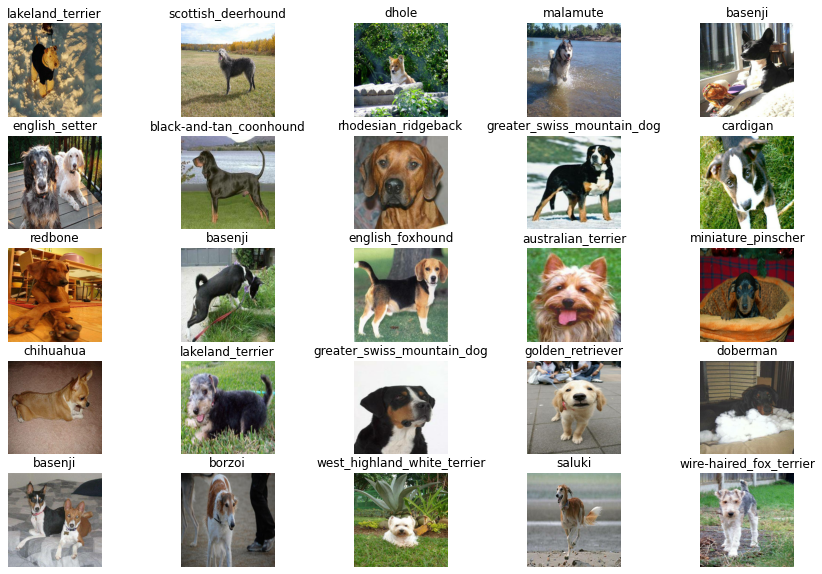

In [ ]:
#Visualizing the data in training batch
show_25_images(train_images, train_labels)
#Notice that it shuggles the images when u run the ^ upper cell and again visualize as because we have shuffle method in the return data into batches functions above 

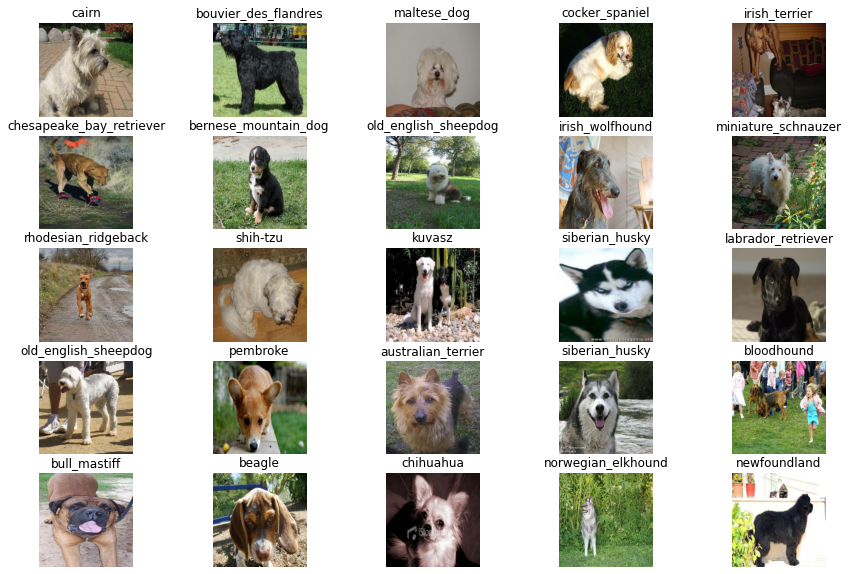

In [ ]:
val_images, val_labels = next(val_data.as_numpy_iterator())
show_25_images(val_images, val_labels)

# Building the model
Before we build a model, there are few things we need to define:
* The input shape (our images shape, in the form of Tensors) to our model.
* The output shape (image labels, in the form of Tensors) of our model.
* The URL of the model that we are using from Tensorflow Hub - [mobilenet_v2](https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5) and its [Paper](https://arxiv.org/abs/1801.04381)

Resources to get models for transfer learning(-is an ML technique where a model trained on one task is re-purposed on a second related task.)
* [Tensorflow Hub](https://tfhub.dev/)
* [Papers with code](https://paperswithcode.com/)
* [Modelzoo](https://modelzoo.co/)
* [Pytorch Hub](https://pytorch.org/hub/), etc..


In [ ]:
IMAGE_SIZE

224

Now we've got the inputs, outputs and model we're using ready to go. We can start to put them together

There are many ways of building a model in TensorFlow but one of the best ways to get started is to use the Keras API.

Defining a deep learning model in Keras can be as straightforward as saying, "here are the layers of the model, the input shape and the output shape, let's go!"

In [ ]:
# Setup input shape to the model
INPUT_SHAPE = [None, IMAGE_SIZE, IMAGE_SIZE, 3]   #batch, height, width,, colour channels

#Setup output shape of our model
OUTPUT_SHAPE = len(unique_breeds) # number of unique labels
 
 #Setup model URL from Tensorflow Hub
MODEL_URL =  "https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5"

**Difference between Keras Sequential and Functional API?**

A Sequential model is appropriate for a plain stack of layers where each layer has exactly one input tensor and one output tensor. In Sequential API we can not create a model that:
share layers
* have branches
* have multiple inputs
* have multiple output



Now we have got our inputs, outputs, and model ready to go. Let's put them together into a Keras deep learning model.
Knowing this lets create function that:
1. Takes the input shape, output shape, and the model we've chosen as parameter 
2. Defines the layers in a Keras model in sequential fashion(do this,then this, then that(in sequence))
3. Compile the model(says it should be evaluated and improved)
4. Builds the model(tells the model the input shape it ill be getting)
5. Returns the model

All of these steps can be found here: 
https://www.tensorflow.org/guide/keras/sequential_model

## Function that build Keras model-`create_model()`
First build the model then jump into intuisive depth


There are two ways to do this in Keras, the functional and sequential API. We've used the sequential.

Which one should you use?

The Keras documentation states the functional API is the way to go for defining complex models but the sequential API (a linear stack of layers) is perfectly fine for getting started, which is what we're doing.

The first layer we use is the model from TensorFlow Hub (hub.KerasLayer(MODEL_URL). So our first layer is actually an entire model (many more layers). This input layer takes in our images and finds patterns in them based on the patterns mobilenet_v2_130_224 has found.

The next layer (tf.keras.layers.Dense()) is the output layer of our model. It brings all of the information discovered in the input layer together and outputs it in the shape we're after, 120 (the number of unique labels we have).

The activation="softmax" parameter tells the output layer, we'd like to assign a probability value to each of the 120 labels somewhere between 0 & 1. The higher the value, the more the model believes the input image should have that label. If we were working on a binary classification problem, we'd use activation="sigmoid".

For more on which activation function to use, see the article Which Loss and Activation Functions Should I Use?

Compiling the model
This one is best explained with a story.

Let's say you're at the international hill descending championships. Where your start standing on top of a hill and your goal is to get to the bottom of the hill. The catch is you're blindfolded.

Luckily, your friend Adam is standing at the bottom of the hill shouting instructions on how to get down.

At the bottom of the hill there's a judge evaluating how you're doing. They know where you need to end up so they compare how you're doing to where you're supposed to be. Their comparison is how you get scored.

Transferring this to model.compile() terminology:

loss - The height of the hill is the loss function, the models goal is to minimize this, getting to 0 (the bottom of the hill) means the model is learning perfectly.
optimizer - Your friend Adam is the optimizer, he's the one telling you how to navigate the hill (lower the loss function) based on what you've done so far. His name is Adam because the Adam optimizer is a great general which performs well on most models. Other optimizers include RMSprop and Stochastic Gradient Descent.
metrics - This is the onlooker at the bottom of the hill rating how well your perfomance is. Or in our case, giving the accuracy of how well our model is predicting the correct image label.

In [ ]:
def create_model(input_shape=INPUT_SHAPE, output_shape=OUTPUT_SHAPE, model_url=MODEL_URL):
  print("Building model with: ", MODEL_URL)

  #Setup the model layers
  model = tf.keras.Sequential([hub.KerasLayer(MODEL_URL),   #Layer 1 (input layer) #this Mobile net will find patterns and  output will be of shape [1,1,1280] 
                               tf.keras.layers.Dense(units=OUTPUT_SHAPE,# we have set a dense layer after output of MobileNetv2, where the dense layer transforms its input to shape of 120(OUTPUT_SHAPE) after the mobilenetv2 has found the patterns
                                                     activation="softmax")  #Layer 2 (output layer)
                              ])
  #Compile the model(defining model how its going to learn)
  model.compile(loss = tf.keras.losses.CategoricalCrossentropy(), #How well our model is guessing
                optimizer = tf.keras.optimizers.Adam(),  #it helps our model improves its guesses
                metrics = ["accuracy"])  #way of evaluating the guesses after its learned
  #Build the model
  model.build(input_shape= [None, IMAGE_SIZE, IMAGE_SIZE, 3]) #My input shape is not the same as required by the model

  return model


##Explaining MobileNETV2

More info about [MobileNETV2 Architecture](https://towardsdatascience.com/review-mobilenetv2-light-weight-model-image-classification-8febb490e61c)

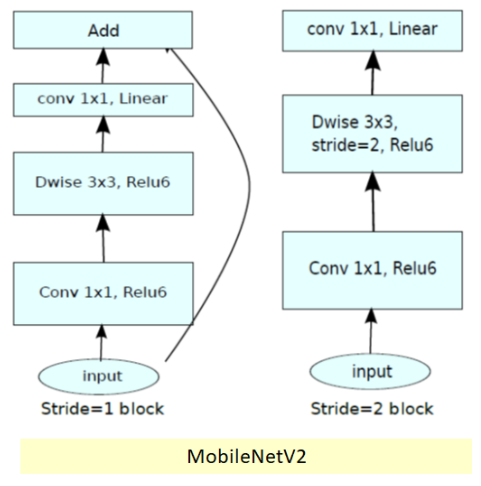

In MobileNetV2, there are two types of blocks. One is residual block with stride of 1. Another one is block with stride of 2 for downsizing.

There are 3 layers for both types of blocks.
* This time, the first layer is 1×1 convolution with ReLU6.
* The second layer is the depthwise convolution.
* The third layer is another 1×1 convolution but without any non-linearity. It is claimed that if ReLU is used again, the deep networks only have the power of a linear classifier on the non-zero volume part of the output domain.



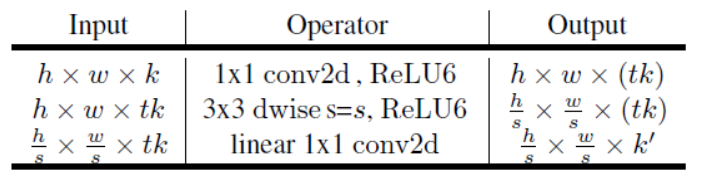
* And there is an expansion factor t. And t=6 for all main experiments.
* If the input got 64 channels, the internal output would get 64×t=64×6=384 channels.

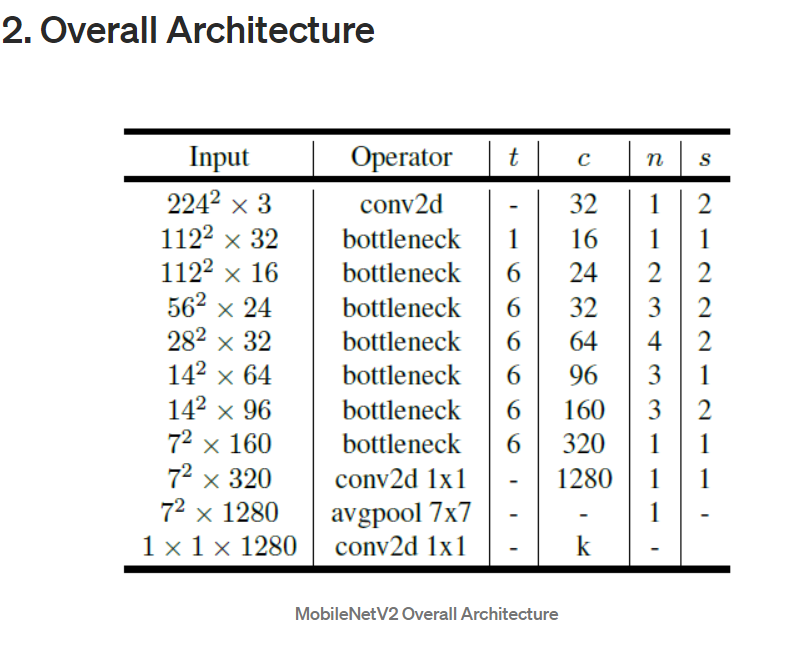
We can see that MobileNetV2 takes input of [224,224,3], and the data goes through various layers and outputs as [1,1,1280] , but we want data as [120] so we have set dense layer after the MobilNetV2 output, Which transforms the shape[1,1,1280] to [120]

In [ ]:
output = np.ones(shape=[1,1,1280])
output  #Its gonna output a long list of various numbers with shape 1,1,1280

array([[[1., 1., 1., ..., 1., 1., 1.]]])

But we dont need this shape[1,1,1280] so we have set a dense layer after output of MobileNetv2, where the dense layer transforms to shape of 120(OUTPUT_SHAPE)

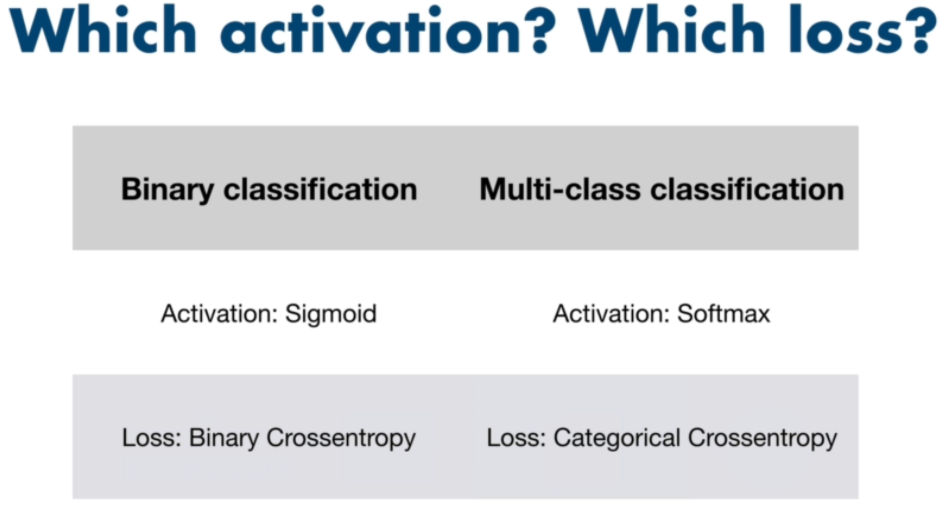
We can search for more suitable loss function on Google

## Model Summary and visualization

In [ ]:
model = create_model() #will use default parameters as set above in def function
model.summary()

Building model with:  https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
keras_layer (KerasLayer)     (None, 1001)              5432713   
_________________________________________________________________
dense (Dense)                (None, 120)               120240    
Total params: 5,552,953
Trainable params: 120,240
Non-trainable params: 5,432,713
_________________________________________________________________


MobileNetV2 weights were originally obtained by training on the ILSVRC-2012-CLS dataset for image classification [("Imagenet").](https://www.image-net.org/index.php).
* **So 5431713(Non-trainable params) are the params that the model had learned originally on the Imagenet, So we get to utilize the patterns that it has learnt on Imagenet, on our own problem.** 
* So rather than try and find the params from scratch on our own(that could take hours and lots compute power that we dont have). We get to utilize the params (model has already learnt) and train our own 120,240 params.
* Its going to use its baseline patterns(5432713) whats in our images, and then we stick the dense layer on top that makes the modelnetv2 using what it has learnt in imagenet for classifying our dog breed



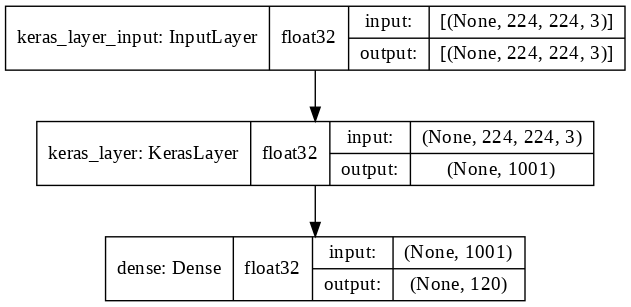

In [ ]:
# We can visualize the model
from tensorflow.keras.utils import plot_model
plot_model(model, to_file='model_plot.png', show_shapes=True, show_layer_names=True, dpi=100, show_dtype=True)


# Creating callbacks
https://www.tensorflow.org/guide/keras/custom_callback?hl=uk

Callbacks are helper functions a model can use during training to:
* save its progress
* check its progress
* stop training early if a model stops improving

Creating two callbacks:
1. One for "TensorBoard", helps us track our model's progress
2. for "Early Stopping, which prevents our model from training for too long.


## Tensorboard callback
To setup a [TensorBoard](https://www.tensorflow.org/api_docs/python/tf/keras/callbacks/TensorBoard?hl=uk) callback, we need to do 3 things:
1. Load the TensorBoard notebook extension
2. Create a TensorBoard Callback which is able to save logs to a directory and pass it to our models `fits` function.
3. Visualize our models training logs with the `%tensorboard` magic function (we will do this after model training).



In [ ]:
#Load Tensorboard notebook extension
#never comment infront of magic function(it ill give error)
%load_ext tensorboard 

In [ ]:
import datetime
#Create a function to build a TensorBoard CallBack
def create_tensorboard_callback():
  #Create a log directory for storing tensorboard logs
  log_dir = os.path.join("/content/drive/MyDrive/logs",
                        datetime.datetime.now().strftime("%Y%m%d-%H%M%S")) #Make it so the logs get tracked whenever we run experiment

  return tf.keras.callbacks.TensorBoard(log_dir)                       
  

##Early stopping callback
It helps our model to prevent overfitting(from learning too well), by stopping a model when a certain evaluation metric stops improving.
 So if a model trains for too long it can actually do so well at finding patterns in a certain dataset, that it is not able to use those patterns on another dataset, so it doesnot generalize well(ability to perform well on unseen dataset)
 
 https://www.tensorflow.org/api_docs/python/tf/keras/callbacks/EarlyStopping?hl=uk

 "Urdu zuban mei" Model ko har ek answer ratta nai merwana model ko usko buss inherent problem solving patterns yaad kerwane hain, take wo practise or final exam mei unseen questions per acha solve ker sake

In [ ]:
#Create early stopping callbacks
early_stopping = tf.keras.callbacks.EarlyStopping(monitor="val_accuracy", 
                                                  patience=3) 
# training will be stopped after 3 No. of epochs with no improvement                                                   

#Training a model(on subset of our data)
Our first model is only going to train on 10,000 images, to make sure everything is working all fine.

Our first model is only going to be trained on 1000 images. Or trained on 800 images and then validated on 200 images, meaning 1000 images total or about 10% of the total data.

We do this to make sure everything is working. And if it is, we can step it up later and train on the entire training dataset.

The final parameter we'll define before training is NUM_EPOCHS (also known as number of epochs).

NUM_EPOCHS defines how many passes of the data we'd like our model to do. A pass is equivalent to our model trying to find patterns in each dog image and see which patterns relate to each label.

If NUM_EPOCHS=1, the model will only look at the data once and will probably score badly because it hasn't a chance to correct itself. It would be like you competing in the international hill descent championships and your friend Adam only being able to give you 1 single instruction to get down the hill.

What's a good value for NUM_EPOCHS?

This one is hard to say. 10 could be a good start but so could 100. This is one of the reasons we created an early stopping callback. Having early stopping setup means if we set NUM_EPOCHS to 100 but our model stops improving after 22 epochs, it'll stop training.

Along with this, let's quickly check if we're still using a GPU.

Epochs =  how many passes of our data we would like our model to do

pass = equavalent to our model finding pattern in each dog image, and see which pattern relate to each label

In [ ]:
NUM_EPOCHS = 100 #@param {type:"slider", min:10, max:100, step:10}

In [ ]:
#Checking if we are still running on the gpu
print("GPU: ", "AVAILABLE...Yessss!!!!🦾" if tf.config.list_physical_devices("GPU") else "NOT FOUND :(")

GPU:  NOT FOUND :(


## Function that `train_model()`
* Create a model using `create_model()`
* Setup a Tensorboard callback using `create_tensorboard_callback()`
* Call the `fit()` function on our model passing it the training data, validation data, number of epochs to train for (`NUM_EPOCHS`) and the call backs  we had like to use
* Return the model

In [ ]:
#Build a function that trains and returns a trained model
def train_model():
  """
  Trains a given model and returns the trained model
  """
  #create model()
  model = create_model()

  #Create new Tensorboard session everytime we train the model
  tensorboard = create_tensorboard_callback()

  #Fit the model to the data passing it the callbacks we created
  model.fit(x=train_data,
            epochs=NUM_EPOCHS,
            validation_data=val_data,    
            validation_freq=1,#how often we need to test the patterns that our model has found on our validation set
             callbacks=[tensorboard, early_stopping])#^ we have set it to 1, so we want to test its patterns model found on the training set, on the validation data every(once an)epoch
  #Return the fitted model
  return model

In [ ]:
#Fit the model to the data
model = train_model()
#First epoch takes the most time because the functions that we have written is getting the data
# and it is initialized aka. data is getting loading the memory of our GPU, 
#Initialization is the process of locating and using the defined values for variable data that is used by a computer program

Building model with:  https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5
Epoch 1/100
25/25 [==============================] - 110s 4s/step - loss: 4.5837 - accuracy: 0.1075 - val_loss: 2.3383 - val_accuracy: 0.5113
Epoch 2/100
25/25 [==============================] - 71s 3s/step - loss: 1.6334 - accuracy: 0.6750 - val_loss: 0.7473 - val_accuracy: 0.9087
Epoch 3/100
25/25 [==============================] - 73s 3s/step - loss: 0.5578 - accuracy: 0.9413 - val_loss: 0.2993 - val_accuracy: 0.9887
Epoch 4/100
25/25 [==============================] - 72s 3s/step - loss: 0.2497 - accuracy: 0.9925 - val_loss: 0.1613 - val_accuracy: 0.9975
Epoch 5/100
25/25 [==============================] - 62s 3s/step - loss: 0.1471 - accuracy: 0.9975 - val_loss: 0.1062 - val_accuracy: 1.0000
Epoch 6/100
25/25 [==============================] - 61s 2s/step - loss: 0.0992 - accuracy: 1.0000 - val_loss: 0.0780 - val_accuracy: 1.0000
Epoch 7/100
25/25 [==============================] - 61s 2s

Its gonna train for 25 steps because (800(train_images)/32(batchsize)) = 25 steps

**Question:** It looks like our model might be overfitting (getting far better results on the training set than the validation set), what are some ways to prevent model overfitting? Hint: this may involve searching something like "ways to prevent overfitting in a deep learning model?".

**Note:** Overfitting to begin with is a good thing. It means our model is learning something.

## Checking Tensorboard logs 

In [ ]:
pip install -U tensorboard-plugin-profile

     |████████████████████████████████| 1.1 MB 5.2 MB/s 


In [ ]:
%tensorboard --logdir /content/drive/MyDrive/logs


Output hidden; open in https://colab.research.google.com to view.

Thanks to our early_stopping callback, the model stopped training after 26 or so epochs (in my case, yours might be slightly different). This is because the validation accuracy failed to improve for 3 epochs.

But the good new is, we can definitely see our model is learning something. The validation accuracy got to 65% in only a few minutes.

This means, if we were to scale up the number of images, hopefully we'd see the accuracy increase.

#Making Prediction
Making predictions with a trained model is as calling predict() on it and passing it data in the same format the model was trained on.

In [ ]:
predictions = model.predict(val_data, verbose=1)
predictions

25/25 [==============================] - 32s 1s/step


array([[3.32627591e-04, 1.34233769e-05, 2.68253585e-04, ...,
        4.21665864e-05, 4.44908392e-06, 4.03838174e-04],
       [8.16901156e-05, 2.08317535e-03, 1.83926363e-06, ...,
        6.83969165e-06, 2.69574030e-05, 9.66331845e-06],
       [2.64526054e-04, 2.93545163e-04, 1.56756709e-04, ...,
        7.92647461e-06, 1.92967545e-05, 1.09507155e-03],
       ...,
       [2.54101120e-04, 7.83000514e-03, 3.09218922e-05, ...,
        4.32899178e-05, 8.91174022e-06, 1.02926024e-04],
       [2.66528659e-04, 3.26758818e-05, 9.10533054e-05, ...,
        2.33927440e-05, 8.47391057e-05, 7.79330323e-04],
       [6.51780865e-05, 1.57400922e-04, 9.23210027e-05, ...,
        1.70558837e-04, 2.16552857e-02, 1.40229449e-05]], dtype=float32)

In [ ]:
predictions.shape

(800, 120)

Making predictions with our model returns an array with a different value for each label.

In this case, making predictions on the validation data (200 images) returns an array (`predictions`) of arrays, each containing 120 different values (one for each unique dog breed).

These different values are the probabilities or the likelihood the model has predicted a certain image being a certain breed of dog. The higher the value, the more likely the model thinks a given image is a specific breed of dog.

Let's see how we'd convert an array of probabilities into an actual label.

##convert array of probs into actual labels

In [ ]:
#First prediction
print(predictions[0])
print(f"Max value (probability of prediction):  {np.max(predictions[0])}")  # the max probability value predicted by the model
print(f"Sum: {np.sum(predictions[0])}")  #the sum of the probability values that's been predicted by the model,because we used softmax activation in our model, this will be close to 1
print(f"Max index: {np.argsort(predictions[0])}") # the index of where the max value in predictions[0] occurs
print(f"Predicted label: {unique_breeds[np.argmax(predictions[0])]}") # the predicted label

[3.32627591e-04 1.34233769e-05 2.68253585e-04 3.81944665e-06
 8.61521403e-04 4.87410143e-05 5.11219318e-04 5.95476478e-04
 1.37738287e-04 1.07369506e-05 3.82057769e-05 1.67243052e-04
 3.63096806e-05 5.99285158e-05 2.09569334e-05 3.41052000e-05
 1.24441984e-04 1.44836435e-03 1.73386179e-05 7.73966312e-05
 7.22962490e-04 8.81696469e-05 1.79239709e-04 7.46025253e-05
 2.03011168e-05 1.23940044e-04 9.39638555e-01 1.93210828e-04
 1.23298480e-04 1.22099847e-03 3.27632333e-05 3.85151980e-05
 9.98966698e-06 2.14109896e-05 1.30654462e-06 8.50494616e-05
 7.71311461e-05 8.59482097e-04 1.35705895e-05 1.97927693e-05
 6.80274388e-05 4.75818815e-05 1.61649459e-05 4.12679481e-04
 3.70571943e-05 2.20998030e-04 1.41677679e-04 2.18324385e-06
 1.11143549e-04 8.70205622e-06 4.55253030e-05 1.78482442e-05
 3.01642576e-05 6.48235218e-05 1.41242390e-05 2.10063772e-05
 9.22763502e-06 5.81395521e-04 5.65928931e-05 3.14687408e-04
 3.51496492e-05 6.54329824e-06 2.15993321e-04 1.91041181e-05
 1.79914186e-05 3.018514

Having this information is great but it would be even better if we could compare a prediction to its true label and original image.

To help us, let's first build a little function to convert prediction probabilities into predicted labels.

Note: Prediction probabilities are also known as confidence levels.

## Turn prediction probabilities into their respective label

In [ ]:
# Turn prediction probabilities into their respective label (easier to understand)
def get_pred_label(prediction_probabilities):
  """
  Turns an array of prediction probabilities into a label.
  """
  return unique_breeds[np.argmax(prediction_probabilities)]

# Get a predicted label based on an array of prediction probabilities
pred_label = get_pred_label(predictions[0])
pred_label

NameError: ignored

## Function to unbatch a batch dataset

Now since our validation data is still in a batch dataset, we will have to unbatch it, to make prediction on validation images and compare with truth labels(validation labels)

In [ ]:
#we need to unbatch the data so that we can compare the prediction labels with the truth labels that are in batch form right now
val_data

<BatchDataset shapes: ((None, 224, 224, 3), (None, 120)), types: (tf.float32, tf.bool)>

In [ ]:
#Intuition of the function unbathify() that we are going to create, so this is just whats going under the hood before we functionize it
images_ = []
labels_ = []

#Loop through unbatched data
for image, label in val_data.unbatch().as_numpy_iterator():
  images_.append(image)
  labels_.append(label)

In [ ]:
images_[0], labels_[0];

In [ ]:
get_pred_label(predictions[0])

'cairn'

In [ ]:
get_pred_label(labels_[0])
#so our model  predicted that correctly as prediction=truth label

'cairn'

In [ ]:
#Function to unbatch a batch data set
def unbatchify(data):
  """
  Take a batched dataset of (images, label) Tensor tuples and returns seperate arrays of images and labels
  """
  images = []
  labels = []
  #loop through the data
  for image, label in data.unbatch().as_numpy_iterator():
    images.append(image)
    labels.append(label)
  return images, labels

In [ ]:
#Unbatchifying the validataion data
val_images, val_labels = unbatchify(val_data)
val_images[0], val_labels[0]

(array([[[0.04452813, 0.0484497 , 0.05629283],
         [0.05633019, 0.06025176, 0.06809489],
         [0.04290967, 0.04683124, 0.05467437],
         ...,
         [0.07345551, 0.02696446, 0.0128119 ],
         [0.08338569, 0.06167922, 0.02458122],
         [0.09094839, 0.07918368, 0.04653312]],
 
        [[0.03778223, 0.04562537, 0.04161626],
         [0.0300378 , 0.03788094, 0.03387184],
         [0.07026608, 0.07810921, 0.07410011],
         ...,
         [0.2120701 , 0.20385231, 0.15405536],
         [0.06193235, 0.04972087, 0.03209355],
         [0.01333135, 0.00152287, 0.00104142]],
 
        [[0.08905759, 0.1049627 , 0.08513602],
         [0.09621842, 0.11212353, 0.09229685],
         [0.05104753, 0.06695264, 0.04712596],
         ...,
         [0.17335822, 0.20798706, 0.14030793],
         [0.3077376 , 0.30949864, 0.20433936],
         [0.37611565, 0.36580402, 0.250109  ]],
 
        ...,
 
        [[0.42239693, 0.37925968, 0.25376946],
         [0.5056203 , 0.4401441 , 0.32190

Now we have got ways to get:
* Prediction Labels
* Validation labels(truth labels)
* Validation Images

Lets make;
## Function to visualize Predicted probability & label with an Image.
we will create a function which:
* Takes an array of prediction possibilities, an array of truth labels, and an array of image and integer
* Convert the prediction possibilities to a predicted label(argmax)
* Plot the predicted label, its predicted probability, the truth label, and the target image on a single plot

In [ ]:
def plot_pred(prediction_probabilities, labels, images, n=1):
  """
  View the prediction, ground truth, and image of sample n
  """
  pred_prob, truth_label, images = prediction_probabilities[n], labels[n], val_images[n]
  #Get the pred label
  pred_label = get_pred_label(pred_prob)
  truth_label = unique_breeds[np.argmax(truth_label)]
  #Plot image and remove ticks
  plt.imshow(images)
  plt.xticks([])
  plt.yticks([])

  #Lets change the colour
  if pred_label == truth_label:
    color = "darkgreen"
  else:
    color = "red"

  #Change plot title to be predicted label, probability of prediction and truth label
  plt.title("{} | {:2f}% | {}".format(pred_label, np.max(pred_prob)*100, truth_label), color=color)


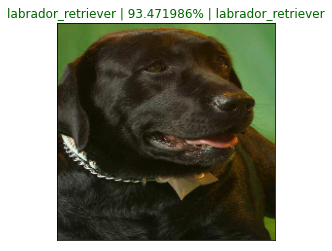

In [ ]:
plot_pred(prediction_probabilities = predictions,
          labels = val_labels,
          images = val_images,
          n=35)

Since we're working with a multi-class problem (120 different dog breeds), it would also be good to see what other guesses our model is making. More specifically, if our model predicts a certain label with 24% probability, what else did it predict?

##Function that visualize top 10 preds confidences of the image
Let's build a function to demonstrate. The function will:
* Take an input of a prediction probabilities array, a ground truth labels array and an integer.
* Find the predicted label using `get_pred_label()`.
* Find the top 10:
  * Prediction probabilities indexes
  * Prediction probabilities values
  * Prediction labels
* Plot the top 10 prediction probability values and labels, coloring the true label green.

In [ ]:
def plot_pred_conf(prediction_probabilities, labels, n=1):
  """
  Plot the top 10 highest prediction confidences, with truth label for sample n
  """
  pred_prob, true_label = prediction_probabilities[n], labels[n]

  #Get the predicted label
  pred_label = get_pred_label(pred_prob)

  #Find the top 10 prediction confidence indexes
  top_10_pred_indexes = pred_prob.argsort()[-10:][::-1]

  #Finding the top 10 prediction confidence values
  top_10_pred_values = pred_prob[top_10_pred_indexes]

  #Finding the top 10 prediction labels
  top_10_pred_labels = unique_breeds[top_10_pred_indexes]

  #Setup plot
  top_plot = plt.bar(np.arange(len(top_10_pred_labels)),
                     top_10_pred_values,
                     color="grey")
  plt.xticks(np.arange(len(top_10_pred_labels)),
              labels=top_10_pred_labels,
              rotation = "vertical")
#Change the color of the true label
  if np.isin:
    top_plot[np.argmax(top_10_pred_labels == true_label)].set_color("green")
  else:
    pass

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:28: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.


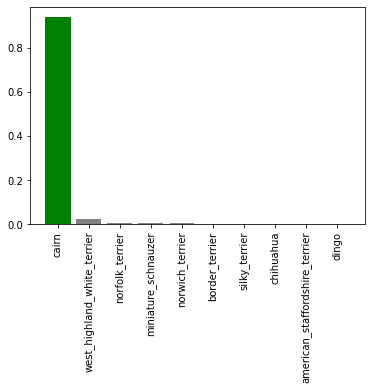

In [ ]:
plot_pred_conf(prediction_probabilities=predictions,
               labels=val_labels,
               n=0);

### Using argsort(optional)
Breaking down the above function how to use argsort to find top 10 probability confidences

In [ ]:
predictions[0]

array([3.32627591e-04, 1.34233769e-05, 2.68253585e-04, 3.81944665e-06,
       8.61521403e-04, 4.87410143e-05, 5.11219318e-04, 5.95476478e-04,
       1.37738287e-04, 1.07369506e-05, 3.82057769e-05, 1.67243052e-04,
       3.63096806e-05, 5.99285158e-05, 2.09569334e-05, 3.41052000e-05,
       1.24441984e-04, 1.44836435e-03, 1.73386179e-05, 7.73966312e-05,
       7.22962490e-04, 8.81696469e-05, 1.79239709e-04, 7.46025253e-05,
       2.03011168e-05, 1.23940044e-04, 9.39638555e-01, 1.93210828e-04,
       1.23298480e-04, 1.22099847e-03, 3.27632333e-05, 3.85151980e-05,
       9.98966698e-06, 2.14109896e-05, 1.30654462e-06, 8.50494616e-05,
       7.71311461e-05, 8.59482097e-04, 1.35705895e-05, 1.97927693e-05,
       6.80274388e-05, 4.75818815e-05, 1.61649459e-05, 4.12679481e-04,
       3.70571943e-05, 2.20998030e-04, 1.41677679e-04, 2.18324385e-06,
       1.11143549e-04, 8.70205622e-06, 4.55253030e-05, 1.78482442e-05,
       3.01642576e-05, 6.48235218e-05, 1.41242390e-05, 2.10063772e-05,
      

In [ ]:
#Using argsort
np.argsort(predictions[0]) #so this returns the indices that would sort the above array, like 26th index value = 1(highest), and  119th index valye = lowest of order in the array

array([ 34,  47,   3, 118, 114,  61, 108,  49,  56,  99,  32,   9,  91,
        78,  76,   1,  38,  54,  42,  18, 112,  51,  64,  63,  66,  39,
        24,  93,  14,  55,  33, 107, 105, 113,  74,  90,  69,  52,  65,
        71,  92,  30,  15,  60,  83,  12,  44,  67,  10,  31, 101, 117,
       110,  50,  97,  41,   5,  75, 115,  85,  58,  13,  53,  40,  23,
        89,  36,  19,  35,  21, 109,  82,  48, 111,  86,  88,  28,  25,
        16,  96,   8,  46,  84,  87,  11,  22,  27,  98,  94,  62,  45,
       104,  70,   2,  72,  59,   0,  73, 106, 119,  43,  80, 100,   6,
        57, 103,   7,  95,  20,  68,  37,   4,  29, 102,  17,  81,  77,
        79, 116,  26])

In [ ]:
np.argmax(predictions[0]) #we can see that at 26th index in argsort array, the value order is 1(highest)

26

In [ ]:
args = np.argsort(predictions[0])
args[-10:] #this wil give us the highest 10 values in ascending order(smaller probability to higher(at 26th index))
#So we going to reverse it

array([ 37,   4,  29, 102,  17,  81,  77,  79, 116,  26])

In [ ]:
args[-10:][::-1] #Just reversing the above array 
# 26th index = highest probability ................37th index = 10th highest probability

array([ 26, 116,  79,  77,  81,  17, 102,  29,   4,  37])

In [ ]:
#So we can write the whole above 2 lines as Showing top 10 indexes of probability confidences
args = predictions[0].argsort()[-10:][::-1]

In [ ]:
#So to get the probability values at the above index we can do
predictions[0][predictions[0].argsort()[-10:][::-1]]

array([9.3963856e-01, 2.6112810e-02, 6.0453005e-03, 4.4950056e-03,
       4.2025717e-03, 1.4483643e-03, 1.3186652e-03, 1.2209985e-03,
       8.6152140e-04, 8.5948210e-04], dtype=float32)

In [ ]:
predictions[0].max()
#so THATS 93.96 the highest confidence at class in 26th index 

0.93963856

In [ ]:
unique_breeds[args]

array(['cairn', 'west_highland_white_terrier', 'norfolk_terrier',
       'miniature_schnauzer', 'norwich_terrier', 'border_terrier',
       'silky_terrier', 'chihuahua', 'american_staffordshire_terrier',
       'dingo'], dtype=object)

## Visualizing various predictions and its values

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:28: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.


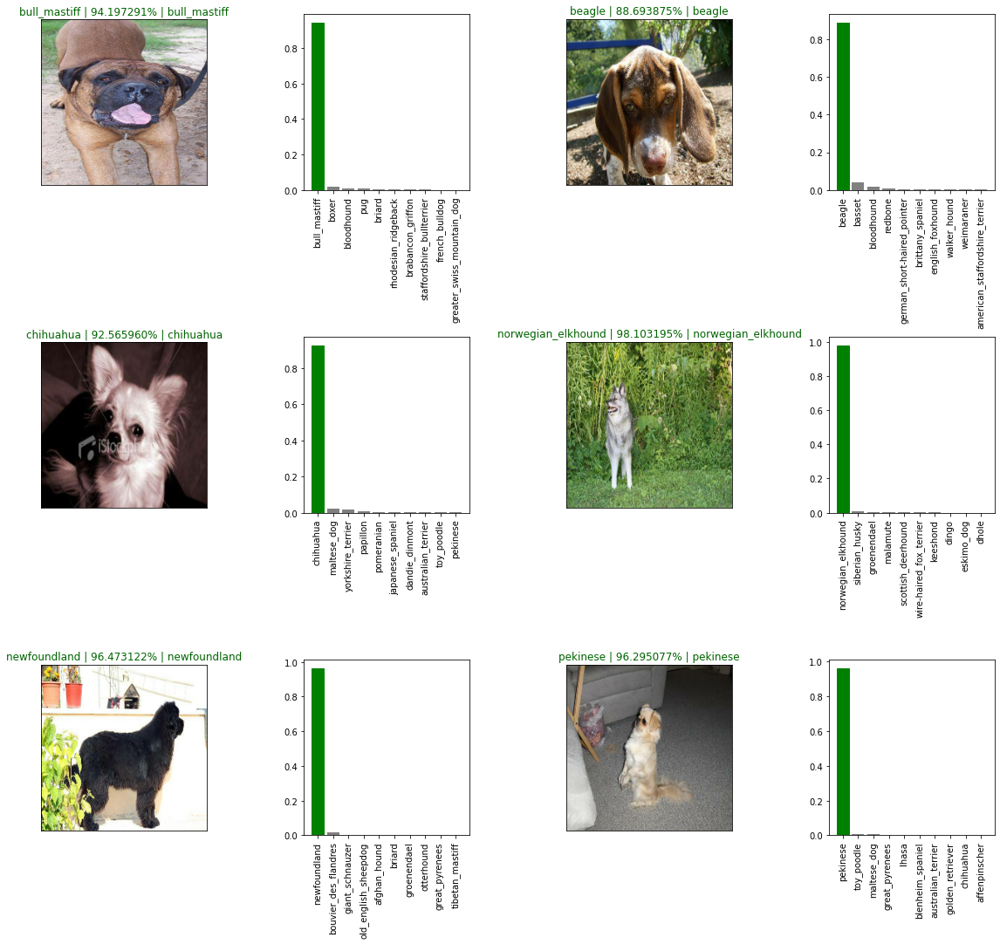

In [ ]:
# Let's check a few predictions and their different values
i_multiplier = 20
num_rows = 3
num_cols = 2
num_images = num_rows*num_cols
plt.figure(figsize=(4*2*num_cols, 5*num_rows))
for i in range(num_images):
  plt.subplot(num_rows, 2*num_cols, 2*i+1)
  plot_pred(prediction_probabilities=predictions,
            labels=val_labels,
            images=val_images,
            n=i+i_multiplier)
  plt.subplot(num_rows, 2*num_cols, 2*i+2)
  plot_pred_conf(prediction_probabilities=predictions,
                labels=val_labels,
                n=i+i_multiplier)
plt.tight_layout(h_pad=1.0)
plt.show();

# Save and load our model
After training a model, it's a good idea to save it. Saving it means you can share it with colleagues, put it in an application and more importantly, won't have to go through the potentially expensive step of retraining it.

The format of an entire saved Keras model is h5. So we'll make a function which can take a model as input and utilise the save() method to save it as a h5 file to a specified directory.


In [ ]:
def save_model(model, suffix=None):
  """
  Save a given model in a model directory and appends a suffix (str) for clarity and reuse
  """
  #Create model directory with current time
  modeldir =  os.path.join("/content/drive/Othercomputers/HP Probook /Machine Learning/Projects/Milestone Projects ZTM/Dog-Vision/models",
                           datetime.datetime.now().strftime("%Y%m&d-%H%M%s"))
  model_path = modeldir + "-" + suffix + ".h5" #save format of the model
  print(f"Saving the model to {model_path} ....")
  model.save(model_path)
  return model_path

If we've got a saved model, we'd like to load it, let's create a function which can take a model path and use the [`tf.keras.models.load_model()`](https://www.tensorflow.org/api_docs/python/tf/keras/models/load_model) function to load it into the notebook.

Because we're using a component from TensorFlow Hub (`hub.KerasLayer`) we'll have to pass this as a parameter to the `custom_objects` parameter.

In [ ]:
def load_model(model_path):
  """
  Load model from a specified path
  """
  print(f"Loading saved model from: {model_path}")
  model = tf.keras.models.load_model(filepath=model_path,
                                     custom_objects={"KerasLayer":hub.KerasLayer})
  print("Loading Complete!")
  return model

In [ ]:
# Lets save our model
# save_model(model, suffix="1000-images-Adam")

Saving the model to /content/drive/Othercomputers/HP Probook /Machine Learning/Projects/Milestone Projects ZTM/Dog-Vision/models/202109&d-14101632319813-1000-images-Adam.h5 ....


'/content/drive/Othercomputers/HP Probook /Machine Learning/Projects/Milestone Projects ZTM/Dog-Vision/models/202109&d-14101632319813-1000-images-Adam.h5'

In [ ]:
#Loading the model
loaded_1000_image_model = load_model("/content/drive/Othercomputers/HP Probook /Machine Learning/Projects/Milestone Projects ZTM/Dog-Vision/models/202109&d-14101632319813-1000-images-Adam.h5")

Loading saved model from: /content/drive/Othercomputers/HP Probook /Machine Learning/Projects/Milestone Projects ZTM/Dog-Vision/models/202109&d-14101632319813-1000-images-Adam.h5
Loading Complete!


In [ ]:
#our model that we trained in this notebook
model.evaluate(val_data)
#so this function is to quickly evaluate on our validation data

25/25 [==============================] - 32s 1s/step - loss: 0.0502 - accuracy: 1.0000


[0.05018050968647003, 1.0]

In [ ]:
#our loaded model
loaded_1000_image_model.evaluate(val_data)

25/25 [==============================] - 31s 1s/step - loss: 0.0502 - accuracy: 1.0000


[0.05018050968647003, 1.0]

So we can see that both our results are same as loaded_model was the same model that we save , 

#Training the model on Full Data 
Now we know our model works on a subset of the data, we can start to move forward with training one on the full data.

Above, we saved all of the training filepaths to `X` and all of the training labels to `y`. Let's check them out.

In [ ]:
# Remind ourselves of the size of the full dataset
len(X), len(y)

(10222, 10222)

We've got over 10,000 images and labels in our training set.

Before we can train a model on these, we'll have to turn them into a data batch.

The beautiful thing is, we can use our `create_data_batches()` function from above which also preprocesses our images for us (thank you past us for writing a helpful function).

In [ ]:
full_data = create_data_batches(X, y)

Creating train data batches....


Our data is in a data batch, all we need now is a model.

Let's use `create_model()` to instantiate another model. 

In [ ]:
full_model = create_model()

Building model with:  https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/5


Since we've made a new model instance, `full_model`, we'll need some callbacks too.

In [ ]:
# Create full model callbacks

# TensorBoard callback
full_model_tensorboard = create_tensorboard_callback()

# Early stopping callback
# Note: No validation set when training on all the data, therefore can't monitor validation accruacy
full_model_early_stopping = tf.keras.callbacks.EarlyStopping(monitor="accuracy",
                                                             patience=3)

To monitor the model whilst it trains, we'll load TensorBoard (it should update every 30-seconds or so whilst the model trains).

In [ ]:
%tensorboard --logdir /content/drive/MyDrive/logs

Output hidden; open in https://colab.research.google.com to view.

**Note:** Since running the cell below will cause the model to train on all of the data (10,000+) images, it may take a fairly long time to get started and finish. However, thanks to our `full_model_early_stopping` callback, it'll stop before it starts going too long.

Remember, the first epoch is always the longest as data gets loaded into memory. After it's there, it'll speed up.


In [ ]:
# Fit the full model to the full training data
full_model.fit(x=full_data,
               epochs=NUM_EPOCHS,
               callbacks=[full_model_tensorboard, 
                          full_model_early_stopping])

Epoch 1/100
320/320 [==============================] - 977s 3s/step - loss: 1.3452 - accuracy: 0.6691
Epoch 2/100
320/320 [==============================] - 401s 1s/step - loss: 0.4042 - accuracy: 0.8819
Epoch 3/100
320/320 [==============================] - 402s 1s/step - loss: 0.2369 - accuracy: 0.9338
Epoch 4/100
320/320 [==============================] - 405s 1s/step - loss: 0.1532 - accuracy: 0.9628
Epoch 5/100
320/320 [==============================] - 407s 1s/step - loss: 0.1065 - accuracy: 0.9783
Epoch 6/100
320/320 [==============================] - 410s 1s/step - loss: 0.0769 - accuracy: 0.9867
Epoch 7/100
320/320 [==============================] - 408s 1s/step - loss: 0.0590 - accuracy: 0.9918
Epoch 8/100
320/320 [==============================] - 408s 1s/step - loss: 0.0456 - accuracy: 0.9942
Epoch 9/100
320/320 [==============================] - 410s 1s/step - loss: 0.0371 - accuracy: 0.9967
Epoch 10/100
320/320 [==============================] - 413s 1s/step - loss: 0.030

### Saving and reloading the full model

Even on a GPU, our full model took a while to train. So it's a good idea to save it.

We can do so using our `save_model()` function.

**Challenge:** It may be a good idea to incorporate the `save_model()` function into a `train_model()` function. Or look into setting up a [checkpoint callback](https://www.tensorflow.org/api_docs/python/tf/keras/callbacks/ModelCheckpoint).

In [ ]:
# Save model to file
save_model(full_model, suffix="all-images-Adam")

Saving the model to /content/drive/Othercomputers/HP Probook /Machine Learning/Projects/Milestone Projects ZTM/Dog-Vision/models/202109&d-17231632331419-all-images-Adam.h5 ....


'/content/drive/Othercomputers/HP Probook /Machine Learning/Projects/Milestone Projects ZTM/Dog-Vision/models/202109&d-17231632331419-all-images-Adam.h5'

In [ ]:
#Loading the model
loaded_full_model = load_model("/content/drive/Othercomputers/HP Probook /Machine Learning/Projects/Milestone Projects ZTM/Dog-Vision/models/202109&d-17231632331419-all-images-Adam.h5")

Loading saved model from: /content/drive/Othercomputers/HP Probook /Machine Learning/Projects/Milestone Projects ZTM/Dog-Vision/models/202109&d-17231632331419-all-images-Adam.h5
Loading Complete!


# Making predictions on the test dataset

Since our model has been trained on images in the form of Tensor batches, to make predictions on the test data, we'll have to get it into the same format.

Luckily we created `create_data_batches()` earlier which can take a list of filenames as input and convert them into Tensor batches.

To make predictions on the test data, we'll:
* Get the test image filenames.
* Convert the filenames into test data batches using `create_data_batches()` and setting the `test_data` parameter to `True` (since there are no labels with the test images).
* Make a predictions array by passing the test data batches to the `predict()` function.**bold text**

In [ ]:
#Loading the test image filenames (since we are using os.listdir(), this already have .jpg)
test_path = "/content/drive/MyDrive/Colab Notebooks/projects_data/DogVision/test/"
test_filenames = [test_path + fname for fname in os.listdir(test_path)]

In [ ]:
# How many test images are there?
len(test_filenames)

10357

In [ ]:
test_data=  create_data_batches(test_filenames, test_data=True)

Creating test data batches....


**Note:** Since there are 10,000+ test images, making predictions could take a while, even on a GPU. So beware running the cell below may take up to an hour.

In [ ]:
test_predictions = loaded_full_model.predict(test_data, verbose=1)

324/324 [==============================] - 1178s 4s/step


In [ ]:
test_predictions[:10]

array([[6.0779531e-10, 7.0040940e-13, 2.7090491e-12, ..., 7.8998884e-13,
        3.7459104e-14, 8.8907882e-07],
       [3.6097989e-12, 1.4416464e-13, 3.6913630e-10, ..., 3.0072785e-11,
        4.5012831e-07, 8.2929036e-10],
       [4.1656678e-10, 2.8194599e-10, 3.2255145e-12, ..., 2.9269593e-09,
        2.0558069e-08, 7.3931661e-09],
       ...,
       [1.1229035e-09, 1.0732475e-12, 3.2539471e-10, ..., 1.4609187e-12,
        1.4872692e-11, 1.9261254e-13],
       [5.0136956e-12, 2.6849782e-09, 9.3039429e-01, ..., 1.2651416e-08,
        4.8617284e-09, 1.9376021e-09],
       [9.6570190e-08, 1.9888950e-10, 1.1933975e-07, ..., 1.2989574e-09,
        1.3716279e-04, 9.5504093e-01]], dtype=float32)

In [ ]:
test_predictions.shape

(10357, 120)

### Preparing test dataset predictions for Kaggle

Looking at the [Kaggle sample submission](https://www.kaggle.com/c/dog-breed-identification/overview/evaluation), it looks like they want the models output probabilities each for label along with the image ID's.

To get the data in this format, we'll:
*   Create a pandas DataFrame with an ID column as well as a column for each dog breed.
*   Add data to the ID column by extracting the test image ID's from their filepaths.
* Add data (the prediction probabilities) to each of the dog breed columns using the `unique_breeds` list and the `test_predictions` list.
* Export the DataFrame as a CSV to submit it to Kaggle.


In [ ]:
["id"] + list(unique_breeds)

['id',
 'affenpinscher',
 'afghan_hound',
 'african_hunting_dog',
 'airedale',
 'american_staffordshire_terrier',
 'appenzeller',
 'australian_terrier',
 'basenji',
 'basset',
 'beagle',
 'bedlington_terrier',
 'bernese_mountain_dog',
 'black-and-tan_coonhound',
 'blenheim_spaniel',
 'bloodhound',
 'bluetick',
 'border_collie',
 'border_terrier',
 'borzoi',
 'boston_bull',
 'bouvier_des_flandres',
 'boxer',
 'brabancon_griffon',
 'briard',
 'brittany_spaniel',
 'bull_mastiff',
 'cairn',
 'cardigan',
 'chesapeake_bay_retriever',
 'chihuahua',
 'chow',
 'clumber',
 'cocker_spaniel',
 'collie',
 'curly-coated_retriever',
 'dandie_dinmont',
 'dhole',
 'dingo',
 'doberman',
 'english_foxhound',
 'english_setter',
 'english_springer',
 'entlebucher',
 'eskimo_dog',
 'flat-coated_retriever',
 'french_bulldog',
 'german_shepherd',
 'german_short-haired_pointer',
 'giant_schnauzer',
 'golden_retriever',
 'gordon_setter',
 'great_dane',
 'great_pyrenees',
 'greater_swiss_mountain_dog',
 'groenen

In [ ]:
#Create a pandas DataFrame  with empty columns
preds_df = pd.DataFrame(columns=["id"]+list(unique_breeds))
preds_df

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,beagle,bedlington_terrier,bernese_mountain_dog,black-and-tan_coonhound,blenheim_spaniel,bloodhound,bluetick,border_collie,border_terrier,borzoi,boston_bull,bouvier_des_flandres,boxer,brabancon_griffon,briard,brittany_spaniel,bull_mastiff,cairn,cardigan,chesapeake_bay_retriever,chihuahua,chow,clumber,cocker_spaniel,collie,curly-coated_retriever,dandie_dinmont,dhole,dingo,doberman,...,norwegian_elkhound,norwich_terrier,old_english_sheepdog,otterhound,papillon,pekinese,pembroke,pomeranian,pug,redbone,rhodesian_ridgeback,rottweiler,saint_bernard,saluki,samoyed,schipperke,scotch_terrier,scottish_deerhound,sealyham_terrier,shetland_sheepdog,shih-tzu,siberian_husky,silky_terrier,soft-coated_wheaten_terrier,staffordshire_bullterrier,standard_poodle,standard_schnauzer,sussex_spaniel,tibetan_mastiff,tibetan_terrier,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier


In [ ]:
#Append test image ID's to predictions DataFrame
test_path

'/content/drive/MyDrive/Colab Notebooks/projects_data/DogVision/test/'

In [ ]:
os.path.splitext(test_filenames[0]) #but we dont want the .jpg split  but we want only the first split with text_filename

('/content/drive/MyDrive/Colab Notebooks/projects_data/DogVision/test/dfefaa03faeab447d6b48e7367255b43',
 '.jpg')

In [ ]:
test_ids = [os.path.splitext(path)[0] for path in os.listdir(test_path)]
test_ids[:5]                      #^SO THIS ZERO MEANS THAT ONLY FIRST SPLIT OF THE SPLITTEXT

['dfefaa03faeab447d6b48e7367255b43',
 'de93f567cf5830e982182435db086b93',
 'e21d378710d164f126e7d0b380dc7a1a',
 'dcd6ca546a353654a136431e6fa70972',
 'e7feb64da6aae1ef8e62453f6660d0c5']

In [ ]:
preds_df["id"] = test_ids
preds_df.head()

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,beagle,bedlington_terrier,bernese_mountain_dog,black-and-tan_coonhound,blenheim_spaniel,bloodhound,bluetick,border_collie,border_terrier,borzoi,boston_bull,bouvier_des_flandres,boxer,brabancon_griffon,briard,brittany_spaniel,bull_mastiff,cairn,cardigan,chesapeake_bay_retriever,chihuahua,chow,clumber,cocker_spaniel,collie,curly-coated_retriever,dandie_dinmont,dhole,dingo,doberman,...,norwegian_elkhound,norwich_terrier,old_english_sheepdog,otterhound,papillon,pekinese,pembroke,pomeranian,pug,redbone,rhodesian_ridgeback,rottweiler,saint_bernard,saluki,samoyed,schipperke,scotch_terrier,scottish_deerhound,sealyham_terrier,shetland_sheepdog,shih-tzu,siberian_husky,silky_terrier,soft-coated_wheaten_terrier,staffordshire_bullterrier,standard_poodle,standard_schnauzer,sussex_spaniel,tibetan_mastiff,tibetan_terrier,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,dfefaa03faeab447d6b48e7367255b43,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,de93f567cf5830e982182435db086b93,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,e21d378710d164f126e7d0b380dc7a1a,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,dcd6ca546a353654a136431e6fa70972,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,e7feb64da6aae1ef8e62453f6660d0c5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
#Add the prediction probabilities to each dog breed column
preds_df[list(unique_breeds)] = test_predictions
preds_df

,id,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,beagle,bedlington_terrier,bernese_mountain_dog,black-and-tan_coonhound,blenheim_spaniel,bloodhound,bluetick,border_collie,border_terrier,borzoi,boston_bull,bouvier_des_flandres,boxer,brabancon_griffon,briard,brittany_spaniel,bull_mastiff,cairn,cardigan,chesapeake_bay_retriever,chihuahua,chow,clumber,cocker_spaniel,collie,curly-coated_retriever,dandie_dinmont,dhole,dingo,doberman,...,norwegian_elkhound,norwich_terrier,old_english_sheepdog,otterhound,papillon,pekinese,pembroke,pomeranian,pug,redbone,rhodesian_ridgeback,rottweiler,saint_bernard,saluki,samoyed,schipperke,scotch_terrier,scottish_deerhound,sealyham_terrier,shetland_sheepdog,shih-tzu,siberian_husky,silky_terrier,soft-coated_wheaten_terrier,staffordshire_bullterrier,standard_poodle,standard_schnauzer,sussex_spaniel,tibetan_mastiff,tibetan_terrier,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
0,dfefaa03faeab447d6b48e7367255b43,6.07795e-10,7.00409e-13,2.70905e-12,3.35684e-11,6.2821e-12,1.65011e-10,2.53287e-12,1.97093e-12,2.63404e-10,1.00995e-08,1.91551e-11,3.74319e-10,3.1822e-13,7.74567e-09,1.99987e-14,1.73601e-09,4.03727e-09,2.43653e-10,4.34232e-11,3.69823e-07,1.73047e-15,4.32556e-11,2.97108e-13,8.09435e-15,0.000419113,4.59113e-12,1.91039e-09,1.23546e-10,1.86876e-11,1.57149e-07,1.20109e-12,3.22111e-09,4.79291e-09,1.62798e-07,5.9642e-10,7.29202e-12,2.47543e-10,1.18201e-11,7.07595e-11,...,1.00424e-10,7.49207e-14,5.60605e-14,3.58205e-14,1.93526e-10,9.22296e-11,9.23523e-15,5.3226e-12,5.77561e-11,8.35273e-13,1.49818e-13,3.03426e-16,6.11619e-12,1.144e-11,3.0257e-11,5.39561e-11,1.7708e-10,7.85717e-11,3.45172e-11,3.66126e-12,3.22842e-08,4.79144e-11,3.05529e-11,7.71827e-12,2.54273e-06,5.87901e-08,2.57235e-12,1.69679e-08,2.0158e-12,4.42796e-12,1.78283e-08,1.16263e-11,5.52479e-09,5.28319e-08,2.43652e-12,5.89314e-07,3.58941e-09,7.89989e-13,3.74591e-14,8.89079e-07
1,de93f567cf5830e982182435db086b93,3.6098e-12,1.44165e-13,3.69136e-10,2.23066e-12,8.88894e-07,1.18973e-09,3.30565e-08,0.00179457,0.000741818,0.84463,1.50667e-12,3.38573e-12,2.75266e-08,1.24655e-05,2.23006e-11,3.94205e-10,6.24184e-12,1.57971e-11,1.57073e-11,2.00452e-10,4.79126e-13,2.81895e-11,7.74074e-10,1.66447e-14,7.68265e-08,1.6105e-12,1.25323e-10,0.110427,1.37784e-11,0.000666706,3.18929e-10,3.24692e-09,3.77932e-09,9.64699e-12,1.49964e-16,7.0755e-10,8.99546e-11,0.0407299,7.21444e-13,...,5.9772e-10,9.76662e-10,1.0284e-16,2.32657e-12,4.24153e-06,2.84406e-10,3.47929e-05,5.17034e-12,9.32635e-12,1.23324e-10,5.36467e-11,1.00967e-18,5.70971e-10,2.15809e-09,2.48136e-10,2.39193e-12,1.85774e-11,3.1809e-14,2.25605e-10,4.19176e-08,4.25622e-05,8.22268e-07,6.1234e-07,6.11968e-09,5.87843e-10,4.09731e-09,2.87507e-14,2.96079e-12,1.73411e-15,1.55691e-11,1.35657e-10,8.53878e-05,8.84984e-08,1.91635e-09,2.86454e-10,8.99964e-08,1.27184e-08,3.00728e-11,4.50128e-07,8.2929e-10
2,e21d378710d164f126e7d0b380dc7a1a,4.16567e-10,2.81946e-10,3.22551e-12,4.89918e-10,1.16245e-10,4.16252e-11,7.82996e-10,1.10871e-12,3.29607e-12,6.24473e-10,7.65575e-12,4.0256e-13,9.99831e-14,1.86062e-11,5.48473e-09,1.37929e-11,2.18156e-14,0.99996,2.6166e-13,4.17992e-12,1.59837e-10,3.19727e-08,3.62955e-05,1.06481e-12,1.13274e-14,5.74157e-11,5.64222e-10,2.57535e-11,2.46388e-11,3.43906e-10,5.03164e-12,3.28999e-13,1.54689e-09,7.71029e-14,5.42056e-13,1.23834e-08,3.33138e-11,7.33984e-11,1.59289e-12,...,1.1368e-11,1.73628e-07,2.48617e-16,2.12843e-13,1.06528e-11,2.55143e-10,2.39783e-11,8.53573e-14,5.82875e-11,2.97573e-10,1.00914e-10,1.02484e-11,1.20799e-11,4.73559e-14,2.10077e-14,1.38141e-09,4.13184e-10,6.65345e-13,1.8879e-08,1.53345e-13,8.78979e-10,2.00073e-15,2.00507e-11,1.29898e-07,5.1663e-09,3.53898e-11,4.53198e-07,2.2418e-10,3.81988e-13,6.45106e-14,5.50518e-07,1.15521e-08,3.30112e-13,2.05599e-13,9.2082e-16,4.81461e-12,1.66354e-12,2.92

In [ ]:
# preds_df.to_csv("/content/drive/Othercomputers/HP Probook /Machine Learning/Projects/Milestone Projects ZTM/Dog-Vision/full_model_predictions_submission1_modelnetv2.csv",
                # index=False)

# Make Prediction on Custom images

To make predictions on custom images we will:
* Get the filepaths of our own images.
* Turn the filepaths into data batches using `create_data_batches()`. And since our custom images won't have labels, we set the `test_data` parameter to `True`.
* Pass the custom image data batch to our model's `predict()` method.
* Convert the prediction output probabilities to prediction labels.
* Compare the predicted labels to the custom images.


In [ ]:
custom_path = "/content/drive/MyDrive/Colab Notebooks/projects_data/DogVision/custom_images/"
custom_image_paths = [custom_path + fname for fname in os.listdir(custom_path)]

In [ ]:
custom_image_paths

['/content/drive/MyDrive/Colab Notebooks/projects_data/DogVision/custom_images/185855912-400x300.jpg',
 '/content/drive/MyDrive/Colab Notebooks/projects_data/DogVision/custom_images/187471021-400x300.jpg',
 '/content/drive/MyDrive/Colab Notebooks/projects_data/DogVision/custom_images/183661295-400x300.jpg',
 '/content/drive/MyDrive/Colab Notebooks/projects_data/DogVision/custom_images/189225950-400x300.jpg']

In [ ]:
#Turn custom_image_paths to data batches
custom_data = create_data_batches(custom_image_paths, test_data=True)
custom_data

Creating test data batches....


<BatchDataset shapes: (None, 224, 224, 3), types: tf.float32>

In [ ]:
#Loading the model
loaded_full_model = load_model("/content/drive/Othercomputers/HP Probook /Machine Learning/Projects/Milestone Projects ZTM/Dog-Vision/models/202109&d-17231632331419-all-images-Adam.h5")

Loading saved model from: /content/drive/Othercomputers/HP Probook /Machine Learning/Projects/Milestone Projects ZTM/Dog-Vision/models/202109&d-17231632331419-all-images-Adam.h5
Loading Complete!


In [ ]:
#Making Prediction on the custom data
custom_predictions = loaded_full_model.predict(custom_data, verbose=1)

InvalidArgumentError: ignored